In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import folium
%matplotlib inline

In [2]:
os.chdir(r'C:\Users\kojaejeung\Desktop\데이터시각화프로젝트\data')

In [3]:
case_data = pd.read_csv('Case.csv')
case_data.head()
# 총 데이터의 양을 확인해준다.
case_data.shape
# 컬럼별 결측치 확인해주기.
case_data.isnull().sum()

 case_id          0
province          0
city              0
group             0
infection_case    0
confirmed         0
latitude          0
longitude         0
dtype: int64

In [4]:
# 전처리 과정.
# 결측치 nan 값의 열 제거
case_data['confirmed'].unique()
case_data = case_data.dropna(axis=0)
case_data.isnull().sum()
# confirmed데이터만 가지고 온다.
infection_case_confirmed = case_data[['infection_case','confirmed']]
infection_case_confirmed

,infection_case,confirmed
0,Itaewon Clubs,139
1,Richway,119
2,Guro-gu Call Center,95
3,Yangcheon Table Tennis Club,43
4,Day Care Center,43
...,...,...
169,etc,20
170,overseas inflow,14
171,contact with patient,0
172,etc,4


In [5]:
# infection_case에 중복되는 값이 있는것 같아 보이니.. groupby를 해줘야 할거 같다.
len(infection_case_confirmed['infection_case'].unique())
# infection_case로 그룹을 묶고, confirmed column에 합계를 보여준후, sort_values(ascending=False)를 사용해서 내림차순 정렬해줘
# ascending=True default값 오름차순정렬
infection_case_sorted = infection_case_confirmed.groupby('infection_case')['confirmed'].sum().sort_values(ascending=False)
infection_case_sorted = infection_case_sorted.reset_index()
infection_case_sorted

,infection_case,confirmed
0,Shincheonji Church,5213
1,contact with patient,1403
2,etc,1192
3,overseas inflow,949
4,Itaewon Clubs,271
...,...,...
76,Uiwang Logistics Center,2
77,Daejeon door-to-door sales,1
78,Gangnam Dongin Church,1
79,Orange Life,1


## 확진자 감염경로 시각화

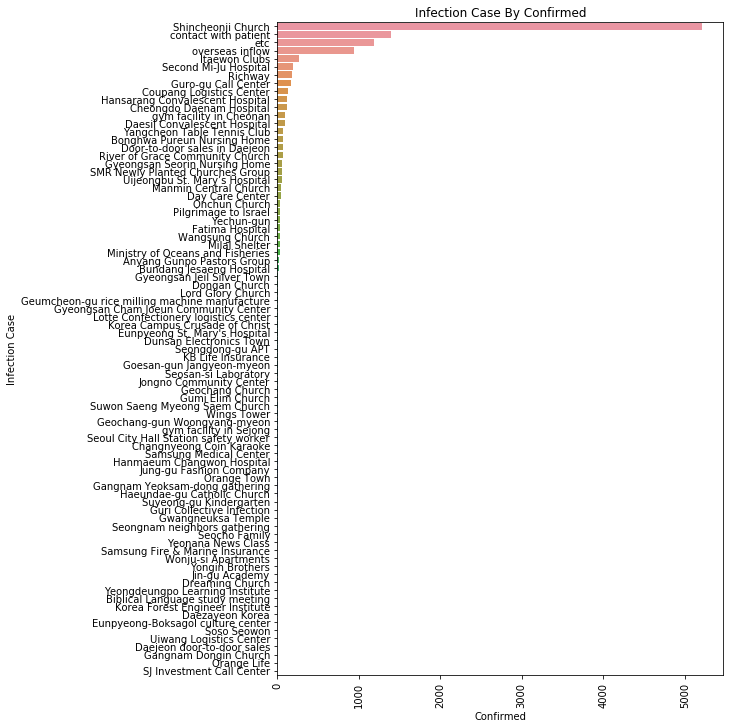

In [6]:
# 전체 데이터 시각화.
plt.figure(figsize=(8,12))
sns.barplot(data=infection_case_sorted, x='confirmed',y='infection_case')
plt.xticks(rotation=90)
plt.xlabel('Confirmed')
plt.ylabel('Infection Case')
plt.title('Infection Case By Confirmed')
plt.show()

## 확진자 감염경로 시각화 (top 10)

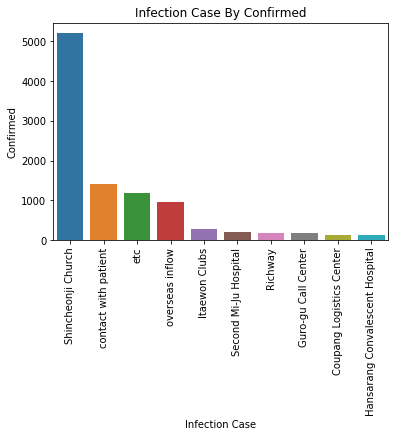

In [7]:
# 시각화를 해주었으나 밑에 의미없는 수치들이 많은 것 같으니 대략 top10개 정도를 제외하고 시각화 해주자
# plt.figure(figsize=(6,6))
sns.barplot(data=infection_case_sorted[:10], x='infection_case',y='confirmed')
plt.xticks(rotation=90)
plt.xlabel('Infection Case')
plt.ylabel('Confirmed')
plt.title('Infection Case By Confirmed')
plt.show()

In [8]:
time_age = pd.read_csv('TimeAge.csv')
time_age.head()
time_age.nunique()

date         121
time           1
age            9
confirmed    827
deceased     107
dtype: int64

In [9]:
time_group = time_age.groupby(['date','age'])[['confirmed','deceased']].sum()
time_group.head(10)
time_group.reset_index(inplace=True)
time_group

,date,age,confirmed,deceased
0,2020-03-02,0s,32,0
1,2020-03-02,10s,169,0
2,2020-03-02,20s,1235,0
3,2020-03-02,30s,506,1
4,2020-03-02,40s,633,1
...,...,...,...,...
1084,2020-06-30,40s,1681,3
1085,2020-06-30,50s,2286,15
1086,2020-06-30,60s,1668,41
1087,2020-06-30,70s,850,82


## 날짜별 누적 확진자 시각화 (age별)

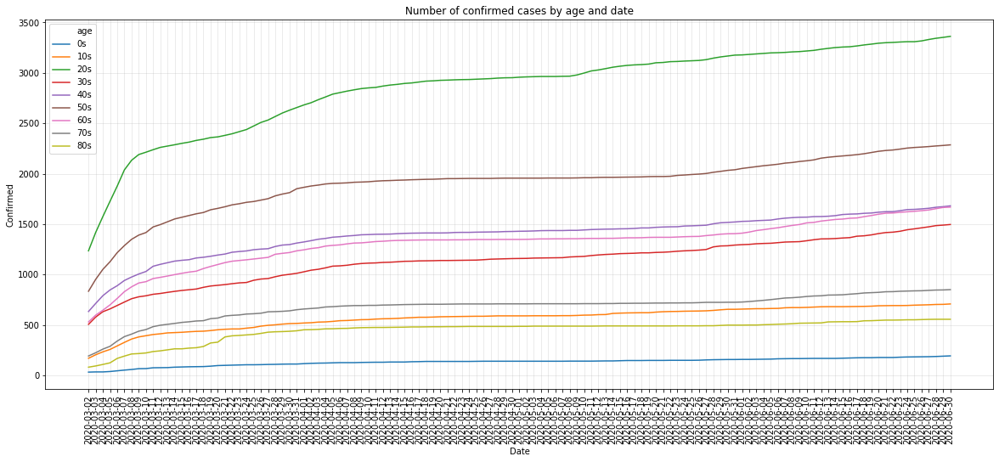

In [49]:
# 날짜별 누적확진자 그래프
plt.figure(figsize=(20,8))
sns.lineplot(data=time_group, x='date',y='confirmed',hue='age')
plt.xticks(rotation=90)
plt.grid(alpha=0.3)
plt.xlabel('Date')
plt.ylabel('Confirmed')
plt.title('Number of confirmed cases by age and date')
plt.show()

## 날짜별 누적 사망자 시각화 (age별)

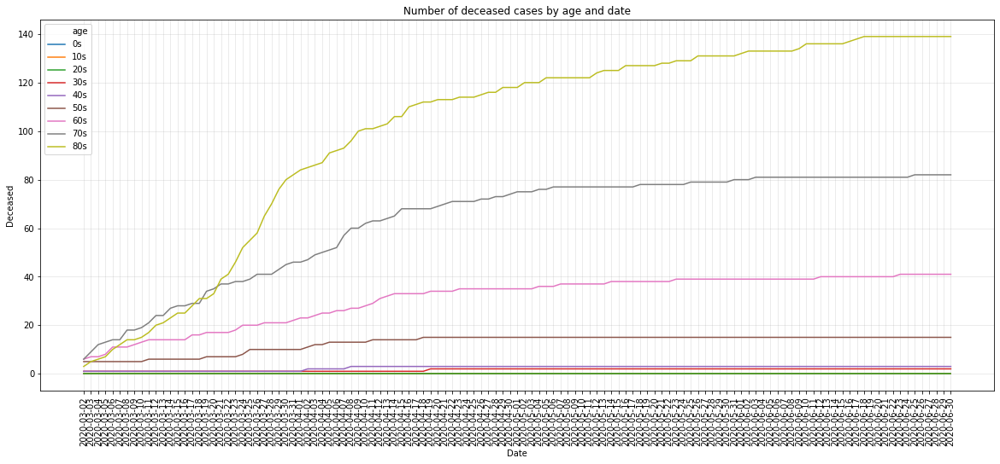

In [48]:
# 날짜별 누적 사망자 그래프
plt.figure(figsize=(20,8))
sns.lineplot(data=time_group, x='date',y='deceased',hue='age')
plt.xticks(rotation=90)
plt.grid(alpha=0.3)
plt.xlabel('Date')
plt.ylabel('Deceased')
plt.title('Number of deceased cases by age and date')
plt.show()

In [12]:
# 0대 당일 확진자, 당일 사망자 전처리 과정.
time_0s = time_group[time_group['age'] == '0s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_0s)-1):
    day_confirmed.append(time_0s.loc[i,'confirmed'] - time_0s.loc[i+1,'confirmed'])

day_deceased = []
for i in range(len(time_0s)-1):
    day_deceased.append(time_0s.loc[i,'deceased'] - time_0s.loc[i+1,'deceased'])

time_0s = time_0s.drop(time_0s.tail(1).index)
time_0s['day_confirmed'] = day_confirmed
time_0s['day_deceased'] = day_deceased
time_0s = time_0s[::-1].reset_index(drop=True)
# display(time_0s)

# 10대 당일 확진자, 당일 사망자 전처리 과정.
time_10s = time_group[time_group['age'] == '10s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_10s)-1):
    day_confirmed.append(time_10s.loc[i,'confirmed'] - time_10s.loc[i+1,'confirmed'])

day_deceased = []
for i in range(len(time_10s)-1):
    day_deceased.append(time_10s.loc[i,'deceased'] - time_10s.loc[i+1,'deceased'])

time_10s = time_10s.drop(time_10s.tail(1).index)
time_10s['day_confirmed'] = day_confirmed
time_10s['day_deceased'] = day_deceased
time_10s = time_10s[::-1].reset_index(drop=True)
# display(time_10s)

# 20대 당일 확진자, 당일 사망자 전처리 과정.
time_20s = time_group[time_group['age'] == '20s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_20s)-1):
    day_confirmed.append(time_20s.loc[i,'confirmed'] - time_20s.loc[i+1,'confirmed'])

day_deceased = []
for i in range(len(time_20s)-1):
    day_deceased.append(time_20s.loc[i,'deceased'] - time_20s.loc[i+1,'deceased'])

time_20s = time_20s.drop(time_20s.tail(1).index)
time_20s['day_confirmed'] = day_confirmed
time_20s['day_deceased'] = day_deceased
time_20s = time_20s[::-1].reset_index(drop=True)
# display(time_20s)

# 30대 당일 확진자, 당일 사망자 전처리 과정.
time_30s = time_group[time_group['age'] == '30s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_30s)-1):
    day_confirmed.append(time_30s.loc[i,'confirmed'] - time_30s.loc[i+1,'confirmed'])
    
day_deceased = []
for i in range(len(time_30s)-1):
    day_deceased.append(time_30s.loc[i,'deceased'] - time_30s.loc[i+1,'deceased'])

time_30s = time_30s.drop(time_30s.tail(1).index)
time_30s['day_confirmed'] = day_confirmed
time_30s['day_deceased'] = day_deceased
time_30s = time_30s[::-1].reset_index(drop=True)
# display(time_30s)

# 40대 당일 확진자, 당일 사망자 전처리 과정.
time_40s = time_group[time_group['age'] == '40s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_40s)-1):
    day_confirmed.append(time_40s.loc[i,'confirmed'] - time_40s.loc[i+1,'confirmed'])
    
day_deceased = []
for i in range(len(time_40s)-1):
    day_deceased.append(time_40s.loc[i,'deceased'] - time_40s.loc[i+1,'deceased'])

time_40s = time_40s.drop(time_40s.tail(1).index)
time_40s['day_confirmed'] = day_confirmed
time_40s['day_deceased'] = day_deceased
time_40s = time_40s[::-1].reset_index(drop=True)
# display(time_40s)

# 50대 당일 확진자, 당일 사망자 전처리 과정.
time_50s = time_group[time_group['age'] == '50s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_50s)-1):
    day_confirmed.append(time_50s.loc[i,'confirmed'] - time_50s.loc[i+1,'confirmed'])
    
day_deceased = []
for i in range(len(time_50s)-1):
    day_deceased.append(time_50s.loc[i,'deceased'] - time_50s.loc[i+1,'deceased'])

time_50s = time_50s.drop(time_50s.tail(1).index)
time_50s['day_confirmed'] = day_confirmed
time_50s['day_deceased'] = day_deceased
time_50s = time_50s[::-1].reset_index(drop=True)
# display(time_50s)

# 60대 당일 확진자, 당일 사망자 전처리 과정.
time_60s = time_group[time_group['age'] == '60s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_60s)-1):
    day_confirmed.append(time_60s.loc[i,'confirmed'] - time_60s.loc[i+1,'confirmed'])

day_deceased = []
for i in range(len(time_60s)-1):
    day_deceased.append(time_60s.loc[i,'deceased'] - time_60s.loc[i+1,'deceased'])

time_60s = time_60s.drop(time_60s.tail(1).index)
time_60s['day_confirmed'] = day_confirmed
time_60s['day_deceased'] = day_deceased
time_60s = time_60s[::-1].reset_index(drop=True)
# display(time_60s)

# 70대 당일 확진자, 당일 사망자 전처리 과정.
time_70s = time_group[time_group['age'] == '70s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_70s)-1):
    day_confirmed.append(time_70s.loc[i,'confirmed'] - time_70s.loc[i+1,'confirmed'])
    
day_deceased = []
for i in range(len(time_70s)-1):
    day_deceased.append(time_70s.loc[i,'deceased'] - time_70s.loc[i+1,'deceased'])

time_70s = time_70s.drop(time_70s.tail(1).index)
time_70s['day_confirmed'] = day_confirmed
time_70s['day_deceased'] = day_deceased
time_70s = time_70s[::-1].reset_index(drop=True)
# display(time_70s)

# 80대 당일 확진자, 당일 사망자 전처리 과정.
time_80s = time_group[time_group['age'] == '80s'][::-1].reset_index(drop=True)

day_confirmed = []
for i in range(len(time_80s)-1):
    day_confirmed.append(time_80s.loc[i,'confirmed'] - time_80s.loc[i+1,'confirmed'])
    
day_deceased = []
for i in range(len(time_80s)-1):
    day_deceased.append(time_80s.loc[i,'deceased'] - time_80s.loc[i+1,'deceased'])

time_80s = time_80s.drop(time_80s.tail(1).index)
time_80s['day_confirmed'] = day_confirmed
time_80s['day_deceased'] = day_deceased
time_80s = time_80s[::-1].reset_index(drop=True)
display(time_80s)

,date,age,confirmed,deceased,day_confirmed,day_deceased
0,2020-03-03,80s,93,5,12,2
1,2020-03-04,80s,108,6,15,1
2,2020-03-05,80s,124,7,16,1
3,2020-03-06,80s,168,10,44,3
4,2020-03-07,80s,191,12,23,2
...,...,...,...,...,...,...
115,2020-06-26,80s,553,139,2,0
116,2020-06-27,80s,555,139,2,0
117,2020-06-28,80s,556,139,1,0
118,2020-06-29,80s,556,139,0,0


In [13]:
# 시각화 코드를 간편하기 위해 전처리를 해주는게 좋을 거 같다.
# 위의 전처리 해주었던 코드를 전부 하나로 합쳐준 후
# hue값에 age를 넣어주면 반복되는 코드가 줄어들수 있을거 같다.
# 데이터 병합 후 day_confirmed과 day_deceased를 하나의 컬럼으로 만들어 준후 style 에 적용 해보기 (연습) 전체 사망자와 전체 확진자의 그래프는 필요 없을거 같지만

# 데이터 합치기 먼저!
time_result = time_0s.append(time_10s, ignore_index=True)
time_result = time_result.append(time_20s, ignore_index=True)
time_result = time_result.append(time_30s, ignore_index=True)
time_result = time_result.append(time_40s, ignore_index=True)
time_result = time_result.append(time_50s, ignore_index=True)
time_result = time_result.append(time_60s, ignore_index=True)
time_result = time_result.append(time_70s, ignore_index=True)
time_result = time_result.append(time_80s, ignore_index=True)
# display(time_result.head())
# day_confirmed와 day_deceased 를 합쳐주기..
time_con = pd.DataFrame(time_result['date'], columns=['date'])
# display(time_con)
time_con['age'] = time_result['age']
time_con['value'] = time_result['day_confirmed']
time_con['confirmed_or_deceased'] = 'day_confirmed'
# display(time_con)
time_dec = pd.DataFrame(time_result['date'], columns=['date'])
time_dec['age'] = time_result['age']
time_dec['value'] = time_result['day_deceased']
time_dec['confirmed_or_deceased'] = 'day_deceased'
time_dec
# 두 새로 생긴 데이터 프레임을 병합
prepro_time_data = time_con.append(time_dec, ignore_index=True)
prepro_time_data

,date,age,value,confirmed_or_deceased
0,2020-03-03,0s,2,day_confirmed
1,2020-03-04,0s,0,day_confirmed
2,2020-03-05,0s,4,day_confirmed
3,2020-03-06,0s,7,day_confirmed
4,2020-03-07,0s,7,day_confirmed
...,...,...,...,...
2155,2020-06-26,80s,0,day_deceased
2156,2020-06-27,80s,0,day_deceased
2157,2020-06-28,80s,0,day_deceased
2158,2020-06-29,80s,0,day_deceased


## 당일 확진자 수 사망자 수 시각화 (age별) <사용하진 않을꺼 같음>

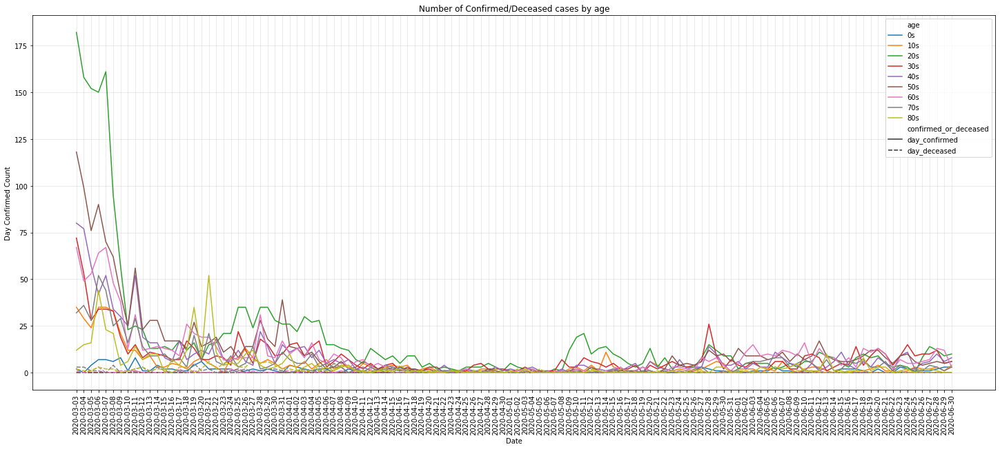

In [50]:
# 당일 확진자 수 사망자 수 시각화 (age별)
plt.figure(figsize=(25,10))
sns.lineplot(data=prepro_time_data, x='date', y='value', hue='age', style='confirmed_or_deceased')
plt.xticks(rotation=90)
plt.xlabel('Date')
plt.ylabel('Day Confirmed Count')
plt.title('Number of Confirmed/Deceased cases by age')
plt.legend()
plt.grid(alpha=0.3)
# plt.ylim(-1,10)
plt.show()

## 연령대별 당일 confirmed 시각화

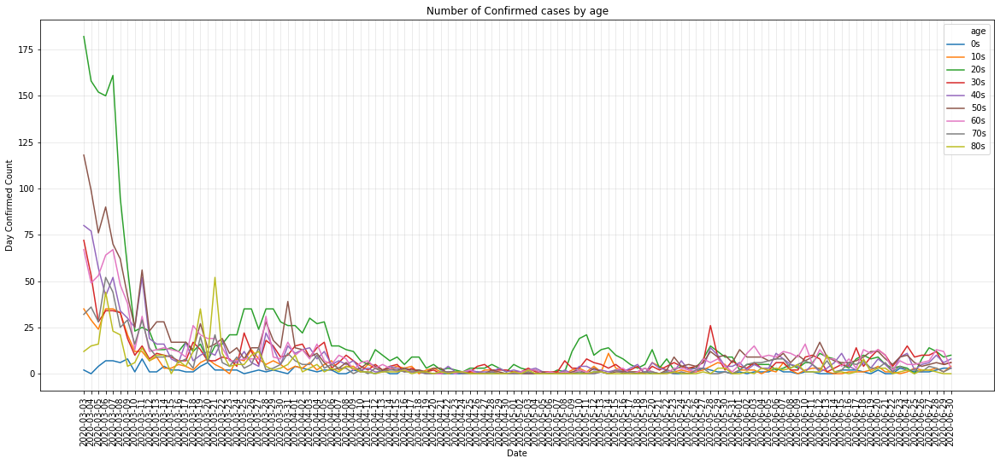

In [51]:
plt.figure(figsize=(20,8))
sns.lineplot(data = time_result, x='date', y='day_confirmed', hue='age')
plt.xticks(rotation=90)
plt.xlabel('Date')
plt.ylabel('Day Confirmed Count')
plt.title('Number of Confirmed cases by age')
# plt.legend()
plt.grid(alpha=0.3)
plt.show()

## 연령대별 당일 Deceased 시각화

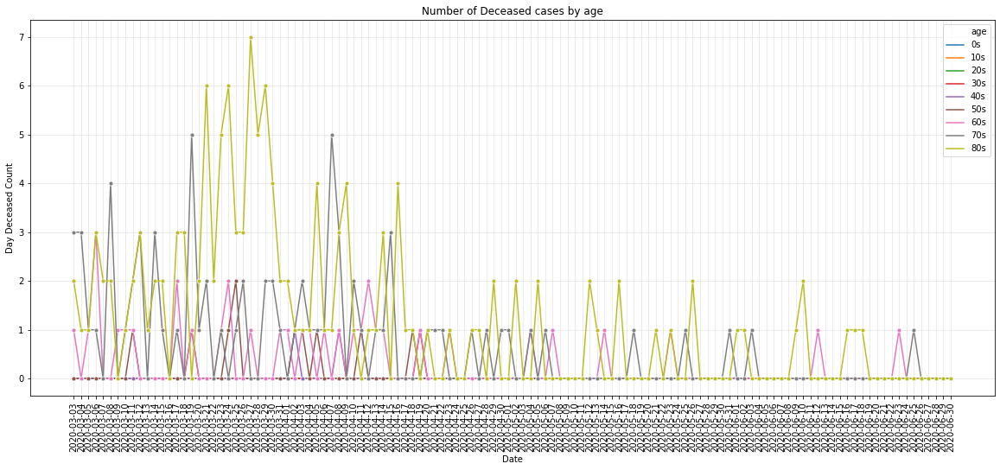

In [16]:
plt.figure(figsize=(20,8))
sns.lineplot(data = time_result, x='date', y='day_deceased', hue='age', marker='o',markersize=5)
plt.xticks(rotation=90)
plt.xlabel('Date')
plt.ylabel('Day Deceased Count')
plt.title('Number of Deceased cases by age')
# plt.legend()
plt.grid(alpha=0.3)
plt.show()

In [17]:
patient_info = pd.read_csv('PatientInfo.csv')
display(patient_info.head())

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50s,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released


In [18]:
# 중복된 환자 ID는 없어 보인다.
print(f"데이터 행의 수 = {patient_info.shape[0]}")
print(f"고유한 환자 ID 수 = {patient_info['patient_id'].nunique()}")

데이터 행의 수 = 5165
고유한 환자 ID 수 = 5164


In [19]:
# patient_info 전처리
patient_info = patient_info[['patient_id','sex','age','country','province','infection_case','contact_number','state']]
# 결측치 확인.
# 환자 id는 결측치 없고, infection_case는 결측치 존재..
# 추후 infection_case의 결측치는 etc와 함께 분류.
patient_info.isnull().sum()
# 감염 경로의 가지수.
patient_info['infection_case'].nunique()

51

In [20]:
# infection_case의 결측값을 제외한 환자의 수.
res = patient_info.groupby('infection_case')['patient_id'].count().sum()
# print('감염 경로 결측값 제외한 환자의 수',res)
res = patient_info.groupby('infection_case')['patient_id'].count()
# print('감염 경로별 환자의 수\n',res)
# reset_index 명령으로 인덱스를 보통의 자료열로 바꿀 수도 있다. 
# 이 때 인덱스 열은 자료열의 가장 선두로 삽입된다. 
# 데이터프레임의 인덱스는 정수로 된 디폴트 인덱스로 바뀐다.
res = res.reset_index()
# 내림차순 정렬
res = res.sort_values('patient_id', ascending=False)
res

,infection_case,patient_id
46,contact with patient,1610
50,overseas inflow,840
47,etc,703
21,Itaewon Clubs,162
30,Richway,128
17,Guro-gu Call Center,112
38,Shincheonji Church,107
5,Coupang Logistics Center,80
42,Yangcheon Table Tennis Club,44
8,Day Care Center,43


## 감염 유형별 환자의 수 시각화

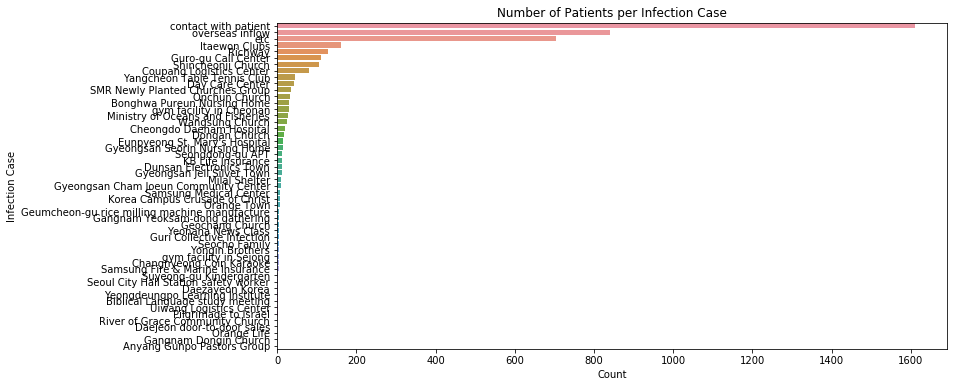

In [21]:
plt.figure(figsize=(12,6))
sns.barplot(y='infection_case', x='patient_id', data=res)
plt.xlabel('Count')
plt.ylabel('Infection Case')
plt.title('Number of Patients per Infection Case')
plt.show()

## 감염 유형별 환자의 수 시각화(top10)

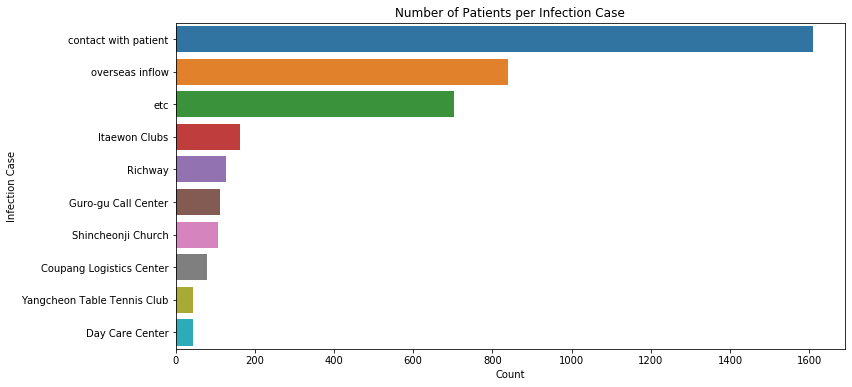

In [22]:
plt.figure(figsize=(12,6))
sns.barplot(y='infection_case', x='patient_id', data=res[:10])
plt.xlabel('Count')
plt.ylabel('Infection Case')
plt.title('Number of Patients per Infection Case')
plt.show()

In [23]:
# 그룹 감염자들만 따로 추출하기 위한 전처리 과정..

In [24]:
# patient_info 데이터 전처리 
my_dict = {'contact with patient':'Individual', 
           'etc':'Unknown', 'overseas inflow':'Overseas'}
# my_dict에 있는 값들이 아니면 모두 집단 감염으로 변경 후 patient_info 데이터 변경해주는 함수
def transe(x):
    if not pd.isnull(x):
        if x in my_dict.keys():
            return my_dict[x]
        else:
            return "Group"
    else:
        return "Unknown"
    
res = patient_info['infection_case'].apply(transe)
res
patient_info['infection_cause'] = res
patient_info

,patient_id,sex,age,country,province,infection_case,contact_number,state,infection_cause
0,1000000001,male,50s,Korea,Seoul,overseas inflow,75,released,Overseas
1,1000000002,male,30s,Korea,Seoul,overseas inflow,31,released,Overseas
2,1000000003,male,50s,Korea,Seoul,contact with patient,17,released,Individual
3,1000000004,male,20s,Korea,Seoul,overseas inflow,9,released,Overseas
4,1000000005,female,20s,Korea,Seoul,contact with patient,2,released,Individual
...,...,...,...,...,...,...,...,...,...
5160,7000000015,female,30s,Korea,Jeju-do,overseas inflow,25,released,Overseas
5161,7000000016,NaN,NaN,Korea,Jeju-do,overseas inflow,NaN,released,Overseas
5162,7000000017,NaN,NaN,Bangladesh,Jeju-do,overseas inflow,72,isolated,Overseas
5163,7000000018,NaN,NaN,Bangladesh,Jeju-do,overseas inflow,NaN,isolated,Overseas


In [25]:
# 새로운 merge dataframe을 만들기 위해 patient_route 데이터 불러온다.
patient_route = pd.read_csv('PatientRoute.csv')
patient_route.head()

,patient_id,global_num,date,province,city,type,latitude,longitude
0,1000000001,2.0,2020-01-22,Gyeonggi-do,Gimpo-si,airport,37.615246,126.715632
1,1000000001,2.0,2020-01-24,Seoul,Jung-gu,hospital,37.567241,127.005659
2,1000000002,5.0,2020-01-25,Seoul,Seongbuk-gu,etc,37.592560,127.017048
3,1000000002,5.0,2020-01-26,Seoul,Seongbuk-gu,store,37.591810,127.016822
4,1000000002,5.0,2020-01-26,Seoul,Seongdong-gu,public_transportation,37.563992,127.029534


In [26]:
patient_group_merge = pd.merge(patient_info, patient_route, on='patient_id')
# patient_group_merge
patient_group_merge = patient_group_merge[['patient_id','date','infection_cause','type','latitude','longitude']]
# patient_group_merge
# 결측치가 없네?
patient_group_merge['infection_cause'].isnull().sum()
patient_group_merge = patient_group_merge[patient_group_merge['infection_cause'] == 'Group']
patient_group_merge

,patient_id,date,infection_cause,type,latitude,longitude
73,1000000015,2020-02-10,Group,store,37.539738,127.053101
74,1000000015,2020-02-14,Group,restaurant,37.557082,127.040100
75,1000000015,2020-02-14,Group,etc,37.554934,127.036743
76,1000000015,2020-02-15,Group,hospital,37.589283,127.064555
77,1000000015,2020-02-15,Group,etc,37.600026,127.106862
...,...,...,...,...,...,...
8023,6100000071,2020-03-02,Group,store,35.392352,128.481636
8024,6100000071,2020-03-02,Group,pc_cafe,35.388459,128.475257
8025,6100000071,2020-03-02,Group,karaoke,35.388960,128.477074
8026,6100000071,2020-03-02,Group,etc,35.388960,128.477074


In [27]:
## 그룹 감염자 이동경로 시각화.

In [28]:
# 전체 감염자 이동경로 시각화.
# 첫 시작 위치 설정 변수
loc = [37.5502, 126.982]
#  for문을 돌기 위한 데이터 총 수를 patient_route_size에 저장
patient_group_merge_size = len(patient_group_merge)
# Map함수를 이용해서 folium의 map객체를 불러온다 location 값에 위에서 설정한 loc값을 사용 // zoom_start 는 얼마나 확대해서 첫화면을 보여줄지 결정
group_map = folium.Map(location=loc, zoom_start=13)

# for문을 돌면서 맵객체에 Circle을 하나씩 추가해 나간다.
for i in range(patient_group_merge_size):
    folium.Circle(list(patient_group_merge.iloc[i][['latitude','longitude']]),
                 popup=patient_group_merge.iloc[i]['type'],
                 radius=100, fill=True, fill_color='#FF0000',color='#FF0000').add_to(group_map)
 
group_map

In [29]:
# 위에서 원본 데이터를 손대서 다시 한번 새롭게 파일을 임포트 해준다. 초기화.
patient_info = pd.read_csv('PatientInfo.csv')
patient_route = pd.read_csv('PatientRoute.csv')
display(patient_info.head())
patient_route.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50s,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released


,patient_id,global_num,date,province,city,type,latitude,longitude
0,1000000001,2.0,2020-01-22,Gyeonggi-do,Gimpo-si,airport,37.615246,126.715632
1,1000000001,2.0,2020-01-24,Seoul,Jung-gu,hospital,37.567241,127.005659
2,1000000002,5.0,2020-01-25,Seoul,Seongbuk-gu,etc,37.592560,127.017048
3,1000000002,5.0,2020-01-26,Seoul,Seongbuk-gu,store,37.591810,127.016822
4,1000000002,5.0,2020-01-26,Seoul,Seongdong-gu,public_transportation,37.563992,127.029534


## 전체 감염자 이동경로 시각화.

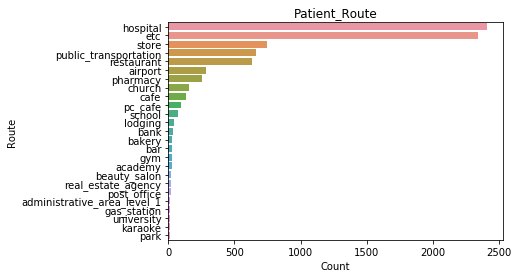

In [30]:
# 감염환자 동선 파악 시각화. (가장 많이 방문한 곳은 어디?)
# 유의미한 방문이니? 유의미하지 않은 방문이니?
res = patient_route.groupby('type').count().sort_values('patient_id',ascending=False)
res = res.reset_index()
res
sns.barplot(y='type',x='patient_id',data=res)
plt.title('Patient_Route')
plt.xlabel('Count')
plt.ylabel('Route')
plt.show()

## 전체 감염자 이동경로 시각화.

In [31]:
# 전체 감염자 이동경로 시각화.
# 첫 시작 위치 설정 변수
loc = [37.5502, 126.982]
#  for문을 돌기 위한 데이터 총 수를 patient_route_size에 저장
patient_route_size = len(patient_route)
# Map함수를 이용해서 folium의 map객체를 불러온다 location 값에 위에서 설정한 loc값을 사용 // zoom_start 는 얼마나 확대해서 첫화면을 보여줄지 결정
route_map = folium.Map(location=loc, zoom_start=13)

# for문을 돌면서 맵객체에 Circle을 하나씩 추가해 나간다.
for i in range(patient_route_size):
    folium.Circle(list(patient_route.iloc[i][['latitude','longitude']]),
                 popup=patient_route.iloc[i]['type'],
                 radius=50, fill=True, fill_color='#FF0000',color='#FF0000').add_to(route_map)
#     break
route_map

In [32]:
# 이태원과 신천지 데이터 시각화를 위해 새롭게 데이터프래임을 만들어 준다.
patient_merge = pd.merge(patient_info, patient_route, on='patient_id')
patient_merge
# 집단 감염 이후 확진자들이 어디로 움직였는지 확인해보자.
patient_merge['infection_case'].unique()
# infection_case의 결측치를 삭제 시켜줘야 하겠다.
patient_merge['infection_case'].isnull().sum()
# infection_case의 결측치를 제거해주는 코드. dropna 함수 이용 infection_case 안에 결측값 모두를 행 방향으로 삭제시켜줘
patient_merge = patient_merge.dropna(subset=['infection_case'], how='any', axis=0).reset_index(drop=True)
patient_merge

,patient_id,sex,age,country,province_x,city_x,infection_case,infected_by,contact_number,symptom_onset_date,...,released_date,deceased_date,state,global_num,date,province_y,city_y,type,latitude,longitude
0,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,...,2020-02-05,NaN,released,2.0,2020-01-22,Gyeonggi-do,Gimpo-si,airport,37.615246,126.715632
1,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,...,2020-02-05,NaN,released,2.0,2020-01-24,Seoul,Jung-gu,hospital,37.567241,127.005659
2,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,...,2020-03-02,NaN,released,5.0,2020-01-25,Seoul,Seongbuk-gu,etc,37.592560,127.017048
3,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,...,2020-03-02,NaN,released,5.0,2020-01-26,Seoul,Seongbuk-gu,store,37.591810,127.016822
4,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,...,2020-03-02,NaN,released,5.0,2020-01-26,Seoul,Seongdong-gu,public_transportation,37.563992,127.029534
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7750,6100000090,male,40s,Korea,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,...,NaN,NaN,released,NaN,2020-03-24,Seoul,Gangseo-gu,airport,37.558654,126.794474
7751,6100000090,male,40s,Korea,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,...,NaN,NaN,released,NaN,2020-03-24,Busan,Gangseo-gu,airport,35.173220,128.946459
7752,6100000090,male,40s,Korea,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,...,NaN,NaN,released,NaN,2020-03-25,Gyeongsangnam-do,Yangsan-si,store,35.336944,129.026389
7753,6100000090,male,40s,Korea,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,...,NaN,NaN,released,NaN,2020-03-25,Gyeongsangnam-do,Yangsan-si,hospital,35.335757,129.025003


In [33]:
# 컬럼 전처리
patient_merge = patient_merge[['date','patient_id','age','infection_case','type','latitude','longitude']]
# patient_merge
# Itaewon Clubs 을 기준으로 한번 뽑아보자.
patient_clubs = patient_merge[patient_merge['infection_case'] == 'Itaewon Clubs']
# patient_clubs
# Shincheonji Church 을 기준으로 한번 뽑아보자.
# 기존 데이터의 양이 부족한듯 보인다...
patient_shincheonji = patient_merge[patient_merge['infection_case'] == 'Shincheonji Church']
# patient_shincheonji.info()

## 이태원클럽, 신천지 집단 감염자 이동동선 시각화 (신천지 데이터는 조금 모자라서 일단 이태원 만)

In [34]:
# 첫 시작 위치 설정 변수
loc = [37.5502, 126.982]
#  for문을 돌기 위한 데이터 총 수를 patient_route_size에 저장
patient_clubs_size = len(patient_clubs)
patient_shincheonji_size = len(patient_shincheonji)
# Map함수를 이용해서 folium의 map객체를 불러온다 location 값에 위에서 설정한 loc값을 사용 // zoom_start 는 얼마나 확대해서 첫화면을 보여줄지 결정
patient_group_map = folium.Map(location=loc, zoom_start=13)

# for문을 돌면서 맵객체에 Circle을 하나씩 추가해 나간다.
for i in range(patient_clubs_size):
    folium.Circle(list(patient_clubs.iloc[i][['latitude','longitude']]),
                 popup=patient_clubs.iloc[i]['type'],
                 radius=100, fill=True, fill_color='#FF0000',color='#FF0000').add_to(patient_group_map)
    
# for i in range(patient_shincheonji_size):
#     folium.Circle(list(patient_shincheonji.iloc[i][['latitude','longitude']]),
#                  popup=patient_shincheonji.iloc[i]['type'],
#                  radius=100, fill=True, fill_color='#0000DB', color='#0000DB').add_to(patient_group_map)

patient_group_map

In [35]:
# 계속 같은 데이터를 사용하는데 위에서 데이터의 변질이 있을 수 있으니
# 다시 한번 데이터를 불러와서 데이터 초기화를 시켜준다.
patient_info = pd.read_csv('PatientInfo.csv')
patient_route = pd.read_csv('PatientRoute.csv')
# display(patient_info)
# display(patient_route)

In [36]:
# 유의미한곳을 간 환자와 유의미하지 않은 곳을 간 환자를 봐보기 위함...
print('감염 후 동선\n',patient_route['type'].unique())
print('감염 후 동선 가지 수',patient_route['type'].nunique())

감염 후 동선
 ['airport' 'hospital' 'etc' 'store' 'public_transportation' 'restaurant'
 'church' 'beauty_salon' 'pharmacy' 'pc_cafe' 'bank' 'academy' 'cafe'
 'bakery' 'bar' 'gym' 'school' 'real_estate_agency' 'karaoke'
 'post_office' 'gas_station' 'park' 'lodging' 'university'
 'administrative_area_level_1']
감염 후 동선 가지 수 25


In [37]:
# 유의미한 변수 추출....
# administrative_area_level_1 이게 뭐지? (국가기관..동사무소같은)
essential = ['hospital','store','public_transportation','pharmacy','bank','school',
             'gas_station','post_office','university','administrative_area_level_1']

# non_essential = ['airport','etc','restaurant','church','beauty_salon','pc_cafe','academy','cafe','bakery','bar',
#                 'gym','real_estate_agency','karaoke','park','lodging']
# 필수적 / 부수적 여부의 변수 생성 is_essential
def isessential(x):
    if x in essential:
        res = True
    else:
        res = False
    return res
patient_route['is_essential'] = patient_route['type'].apply(isessential)
patient_route

,patient_id,global_num,date,province,city,type,latitude,longitude,is_essential
0,1000000001,2.0,2020-01-22,Gyeonggi-do,Gimpo-si,airport,37.615246,126.715632,False
1,1000000001,2.0,2020-01-24,Seoul,Jung-gu,hospital,37.567241,127.005659,True
2,1000000002,5.0,2020-01-25,Seoul,Seongbuk-gu,etc,37.592560,127.017048,False
3,1000000002,5.0,2020-01-26,Seoul,Seongbuk-gu,store,37.591810,127.016822,True
4,1000000002,5.0,2020-01-26,Seoul,Seongdong-gu,public_transportation,37.563992,127.029534,True
...,...,...,...,...,...,...,...,...,...
8087,6100000090,NaN,2020-03-24,Seoul,Gangseo-gu,airport,37.558654,126.794474,False
8088,6100000090,NaN,2020-03-24,Busan,Gangseo-gu,airport,35.173220,128.946459,False
8089,6100000090,NaN,2020-03-25,Gyeongsangnam-do,Yangsan-si,store,35.336944,129.026389,True
8090,6100000090,NaN,2020-03-25,Gyeongsangnam-do,Yangsan-si,hospital,35.335757,129.025003,True


In [38]:
# 결측치 확인해준다. patient_info 데이터와 patient_route 데이터의 patient_id로 merge
# 연령대 별 위도 경도가 필요. age결측치가 많이 보인다... 결측치 열 삭제 하면 될듯?! 
patient_map_merge = pd.merge(patient_route, patient_info,on='patient_id')
patient_map_merge.isnull().sum()
# shape 확인
patient_map_merge.shape
# age의 유니크한 값들 확인 nan 값 확인 할 수 있습니다. nan값을 가진 열은 모두 삭제 할거야.
patient_map_merge['age'].unique()
# dropna의 subset=['age'] 옵션을 사용해서 age에 결측치가 있는 모든 행을 삭제 시켜준다. reset_index() index값 초기화 drop=True 사용해서 index 튀어나오지 않게 해준다.
patient_map_merge = patient_map_merge.dropna(subset=['age'], how='any', axis=0).reset_index(drop=True)
# 데이터 확인
patient_map_merge

,patient_id,global_num,date,province_x,city_x,type,latitude,longitude,is_essential,sex,...,province_y,city_y,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,2.0,2020-01-22,Gyeonggi-do,Gimpo-si,airport,37.615246,126.715632,False,male,...,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000001,2.0,2020-01-24,Seoul,Jung-gu,hospital,37.567241,127.005659,True,male,...,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
2,1000000002,5.0,2020-01-25,Seoul,Seongbuk-gu,etc,37.592560,127.017048,False,male,...,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
3,1000000002,5.0,2020-01-26,Seoul,Seongbuk-gu,store,37.591810,127.016822,True,male,...,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
4,1000000002,5.0,2020-01-26,Seoul,Seongdong-gu,public_transportation,37.563992,127.029534,True,male,...,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6768,6100000090,NaN,2020-03-24,Seoul,Gangseo-gu,airport,37.558654,126.794474,False,male,...,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,2020-03-26,NaN,NaN,released
6769,6100000090,NaN,2020-03-24,Busan,Gangseo-gu,airport,35.173220,128.946459,False,male,...,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,2020-03-26,NaN,NaN,released
6770,6100000090,NaN,2020-03-25,Gyeongsangnam-do,Yangsan-si,store,35.336944,129.026389,True,male,...,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,2020-03-26,NaN,NaN,released
6771,6100000090,NaN,2020-03-25,Gyeongsangnam-do,Yangsan-si,hospital,35.335757,129.025003,True,male,...,Gyeongsangnam-do,Yangsan-si,overseas inflow,NaN,NaN,2020-03-25,2020-03-26,NaN,NaN,released


In [39]:
# 연령대별 데이터 전처리 과정 (20대와 30대를 묶고 // 40대와 50대를 묶고 // 60대와 70대를 묶어서 시각화 해보자.)
# patient_map_merge['age']가 20인것과 30인것의 데이터 만 따로 map_20s_30s 변수에 담아준다.
map_20s_30s = patient_map_merge[(patient_map_merge['age'] == '20s') | (patient_map_merge['age'] == '30s')]
# 필요한 컬럼들만 가지고 와준다.
map_20s_30s = map_20s_30s[['patient_id','type','latitude','longitude','age']]
# display(map_20s_30s)

# 위의 과정과 동일
map_40s_50s = patient_map_merge[(patient_map_merge['age'] == '40s') | (patient_map_merge['age'] == '50s')]
map_40s_50s = map_40s_50s[['patient_id','type','latitude','longitude','age']]
# display(map_40s_50s)

map_60s_70s = patient_map_merge[(patient_map_merge['age'] == '60s') | (patient_map_merge['age'] == '70s')]
map_60s_70s = map_60s_70s[['patient_id','type','latitude','longitude','age']]
map_60s_70s

,patient_id,type,latitude,longitude,age
32,1000000010,church,37.586288,126.999716,60s
33,1000000010,church,37.586288,126.999716,60s
34,1000000010,hospital,37.602643,127.039518,60s
35,1000000010,hospital,37.578708,126.997551,60s
60,1000000014,etc,37.564091,126.997940,60s
...,...,...,...,...,...
6712,6100000072,store,35.541315,128.500770,60s
6713,6100000073,hospital,35.400055,128.842889,60s
6718,6100000081,hospital,35.805371,127.917761,70s
6764,6100000089,etc,35.333368,128.497988,60s


## 연령대 별 확진자 이동경로

In [40]:
# 20~30대 확진자 경로 // 40~50대 확진자 경로 // 60~70대 확진자 경로
# 20~30 파랑색 // 40~50 빨강색 // 60~70 초록색

loc = [37.5502, 126.982]

map_20s_30s_size = len(map_20s_30s)
map_40s_50s_size = len(map_40s_50s)
map_60s_70s_size = len(map_60s_70s)

result_map = folium.Map(location=loc, zoom_start=13)

for i in range(map_20s_30s_size):
    folium.Circle(list(map_20s_30s.iloc[i][['latitude','longitude']]),
                 popup=map_20s_30s.iloc[i]['type'],
                 radius=70, fill=True, fill_color='#0000DB',color='#0000DB').add_to(result_map)

for i in range(map_40s_50s_size):
    folium.Circle(list(map_40s_50s.iloc[i][['latitude','longitude']]),
                 popup=map_40s_50s.iloc[i]['type'],
                 radius=70, fill=True, fill_color='#FF7012',color='#FF7012').add_to(result_map)
    
for i in range(map_60s_70s_size):
    folium.Circle(list(map_60s_70s.iloc[i][['latitude','longitude']]),
                 popup=map_60s_70s.iloc[i]['type'],
                 radius=70, fill=True, fill_color='#006F00',color='#006F00').add_to(result_map)
    
result_map

In [41]:
# 순용강사님 코드.. 아직 다 알지는 못하지만.. 다시 한번 확인 필요..
patient_route['route_value'] = 1
# print(patient_route)
result_route = pd.pivot_table(data=patient_route, index='patient_id',
                               columns='is_essential',values='route_value',
                               aggfunc='sum', fill_value=0)
# result_route
# 컬럼명 재설정
result_route.columns.name=None
result_route = result_route.reset_index()
result_route = result_route.rename(columns={False:'non_essential',True:'essential'})
result_route
patient_merge = patient_info.merge(result_route, left_on='patient_id', right_on='patient_id', how='inner')
patient_merge

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,non_essential,essential
0,1000000001,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released,1,1
1,1000000002,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released,4,9
2,1000000003,male,50s,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released,2,0
3,1000000004,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released,0,1
4,1000000005,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1467,6100000086,male,50s,Korea,Gyeongsangnam-do,Changwon-si,etc,NaN,NaN,2020-03-15,2020-03-19,2020-05-04,NaN,released,1,3
1468,6100000087,female,50s,Korea,Gyeongsangnam-do,Changwon-si,etc,NaN,NaN,2020-03-16,2020-03-21,2020-05-06,NaN,released,2,6
1469,6100000088,male,20s,Korea,Gyeongsangnam-do,Changwon-si,etc,NaN,NaN,2020-03-06,2020-03-22,2020-04-19,NaN,released,19,5
1470,6100000089,male,60s,Korea,Gyeongsangnam-do,Haman-gun,etc,6002000035,NaN,2020-03-22,2020-03-23,NaN,NaN,released,1,1


In [42]:
# 나이대별 필요한곳 방문한 경우 // 필요하지 않은곳 방문한 경우
age_essential = patient_merge.groupby('age')[['non_essential','essential']].sum()
age_essential = age_essential.reset_index()
age_essential

,age,non_essential,essential
0,0s,26,46
1,10s,173,183
2,20s,1009,893
3,30s,519,547
4,40s,568,561
5,50s,583,650
6,60s,375,356
7,70s,90,115
8,80s,10,61
9,90s,2,6


In [43]:
# 새로운 데이터 프레임을 만들어서 내가 원하는 시각화를 할 수 있게 전처리해준다.
# age_e 라는 새로운 dataframe생성 columns명은 age Series 내용물은 age_essential['age']
age_e = pd.DataFrame(age_essential['age'], columns=['age'])
# display(age_e)
# age_e['value'] 라는 컬럼을 새로 만들어 주고, 값은 age_essential['essential']을 넣어준다.
age_e['value'] = age_essential['essential']
# display(age_e)
# age_e['is_essential'] 라는 컬럼을 새로 만들어 주고, 값은 모두 essential로 채워준다.
age_e['is_essential'] = 'essential'
# display(age_e)

# 위의 과정과 동일
age_n = pd.DataFrame(age_essential['age'], columns=['age'])
age_n['value'] = age_essential['non_essential']
age_n['is_essential'] = 'non_essential'
age_n

# age라는 새로운 변수에 age_e값에 age_n을 append 시켜준다. ignore_index=True 를 사용해 인덱스 초기화 시켜준다.
age = age_e.append(age_n, ignore_index=True)
display(age)

,age,value,is_essential
0,0s,46,essential
1,10s,183,essential
2,20s,893,essential
3,30s,547,essential
4,40s,561,essential
5,50s,650,essential
6,60s,356,essential
7,70s,115,essential
8,80s,61,essential
9,90s,6,essential


## 연령대별 필수적인곳을 방문한 사람 수와 필수적이지 않은 곳을 방문한 사람 수 시각화

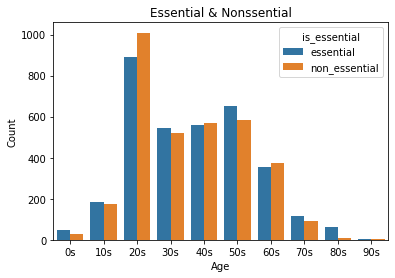

In [44]:
sns.barplot(data=age,x='age',y='value',hue='is_essential')
plt.xlabel('Age')
plt.ylabel('Count')
plt.title('Essential & Nonssential')
plt.show()

In [45]:
# 서울 유동인구에 대해 시각화 하기 위해 seoulfloating 데이터 로드
seoul_floating = pd.read_csv('SeoulFloating.csv')
seoul_floating

,date,hour,birth_year,sex,province,city,fp_num
0,2020-01-01,0,20,female,Seoul,Dobong-gu,19140
1,2020-01-01,0,20,male,Seoul,Dobong-gu,19950
2,2020-01-01,0,20,female,Seoul,Dongdaemun-gu,25450
3,2020-01-01,0,20,male,Seoul,Dongdaemun-gu,27050
4,2020-01-01,0,20,female,Seoul,Dongjag-gu,28880
...,...,...,...,...,...,...,...
1084795,2020-05-31,21,40,female,Seoul,Dobong-gu,27620
1084796,2020-05-31,21,40,female,Seoul,Songpa-gu,56560
1084797,2020-05-31,21,50,female,Seoul,Gangdong-gu,38960
1084798,2020-05-31,22,60,female,Seoul,Guro-gu,25420


In [46]:
# 그래프 그리기 위해 다시 한번 전처리 과정
# age_m이라는 새로운 데이터 프레임을 만들어 준다. 컬럼명은 age, 내용물은 seoul_floating['birth_year']의 유니크한 값을 사용(20~70이 들어있음)
age_m = pd.DataFrame(seoul_floating['birth_year'].unique(), columns=['age'])
# display(age_m)
# moring_floating 변수에 오전에 해당하는 새로운 데이터프레임을 할당해준다.
moring_floating = seoul_floating[(seoul_floating['hour'] > 5) & (seoul_floating['hour'] < 12)].reset_index(drop=True)
# display(moring_floating.head(20))
# age_m['value'] 라는 새로운 컬럼을 만들어주고 moring_floating.groupby를 활용해 연령별 유동인구 합을 구해준다.
age_m['value'] = moring_floating.groupby('birth_year')['fp_num'].sum().reset_index(drop=True)
# display(age_m)
# age_m['ist_time'] 라는 새로운 컬럼을 만들어 준 후 moring 값을 전부 넣어 준다.
age_m['is_time'] = 'moring'
# display(age_m)

# age_a afternoon을 age별로 전처리한 변수
age_a = pd.DataFrame(seoul_floating['birth_year'].unique(), columns=['age'])
afternoon_floating = seoul_floating[(seoul_floating['hour'] > 11) & (seoul_floating['hour'] < 18)].reset_index(drop=True)
age_a['value'] = afternoon_floating.groupby('birth_year')['fp_num'].sum().reset_index(drop=True)
age_a['is_time'] = 'afternoon'
# display(age_a)

# age_e evening을 age별로 전처리한 변수
age_e = pd.DataFrame(seoul_floating['birth_year'].unique(), columns=['age'])
evening_floating = seoul_floating[(seoul_floating['hour'] > 17) & (seoul_floating['hour'] < 24)].reset_index(drop=True)
age_e['value'] = evening_floating.groupby('birth_year')['fp_num'].sum().reset_index(drop=True)
age_e['is_time'] = 'evening'
# display(age_e)

# 각각의 데이터를 밑에다 붙이는 방법 (다른 방법도 있는 듯 함...) ignore_index=True 는 index값 초기화 시키는 것
result_floating_data = age_m.append(age_a, ignore_index=True)
result_floating_data = result_floating_data.append(age_e, ignore_index=True)
result_floating_data

,age,value,is_time
0,20,1359088300,moring
1,30,1533206190,moring
2,40,1529069490,moring
3,50,1421639860,moring
4,60,923732010,moring
5,70,701528440,moring
6,20,1411746040,afternoon
7,30,1570641730,afternoon
8,40,1554025040,afternoon
9,50,1426356320,afternoon


## 서울 시간대별 연령별 유동인구 시각화

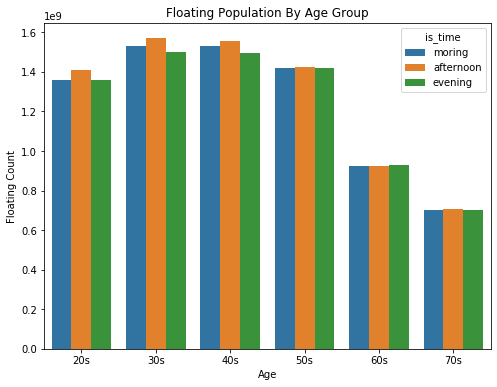

In [47]:
fig, ax = plt.subplots(figsize=(8,6))
ax = sns.barplot(data=result_floating_data, x='age',y='value',hue='is_time')
ax.set(xticklabels=['20s','30s','40s','50s','60s','70s'])
plt.xlabel('Age')
plt.ylabel('Floating Count')
plt.title('Floating Population By Age Group')
plt.show()